In [1]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'breast-ultrasound-images-dataset:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F1209633%2F2021025%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240221%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240221T130800Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D61be185fc9b27b64c5b02a2168a043507213b7de8e1a5ecadbfcbae22fe8a9e2f7de8a5c5b0608104ad6bc00610406260ba56265aa3dd72c4c02825ec6ba8cd6d28960dc26498cc9d7e1f633f3b652757a3fcad582882467f56edf0e98e97fd62214768faca2ef5ffa034e320b8106b0cf3e9d53fd63a0edd2a4e88219799807bab7bc12ed42e94459b05c594e5d134a6815a2216e5eb5902495d0048d286f122d1d8290a86b952c4274d8d546ba11856c6818feab0eb9608a645a02816f058c275d425bd851b5351602aa240ea3f41957620e0d83688f4667a747c6b75cf98501aa2cce3a77deee1e0a846fc165dead539197dbcf9ed1cd275e15cfe35937ee,breast-cancer-detection-unet:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F2456391%2F4161522%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240221%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240221T130801Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D8c9ae78669c2b324fec9a68d88ebfc55579fd24f89453e3f1e944fbfc5a060ae82a068f0d8a69b1827a29d09a3188a04e300ec2aa676348fe1b57ac49ce08377053b08c237b409cc8bf032afd5e7d5a1322b047f1057ea6696088c9dad8b299475468be0e881c9fec9ad35c38e90fcaae7096fb34412961552fa4d38ee7ebbd7b5a52799e6af5f0fbc5fa06eeb30dad427b8aaa5e27b3708b780b881d7a5e4d24d93787519b421cc942e6e71bd802f5a3a688352269e57219ea4c81d58cff735671a55bf97e9210c40caf3275a25a0b29319087170e92c389647e22189c67215b70134106f0b7d7df44148202b381d16226795000da0bd70b7d3cf798bdae71e'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')

[==================================================] 204421470 bytes downloaded
Downloaded and uncompressed: breast-ultrasound-images-dataset
[==================================================] 111340709 bytes downloaded
Downloaded and uncompressed: breast-cancer-detection-unet
Data source import complete.


# **Introduction**

**About Dataset**

* **Breast cancer** is one of the **most common** causes of death among **women worldwide**. Early detection helps in reducing the **number of early deaths**. The data reviews the **medical images of breast cancer** using ultrasound scan. **Breast Ultrasound Dataset** is categorized into **three classes** $:$ **normal, benign, and malignant images**. **Breast ultrasound images** can produce great results in **classification, detection, and segmentation** of breast cancer when combined with machine learning.

* The data collected at baseline include **breast ultrasound images among women** in ages between 25 and 75 years old. This data was collected in **2018**. The number of patients is **600 female patients**. The dataset consists of **780 images** with an **average image size of 500*500 pixels**. The images are in PNG format. The ground truth images are presented with original images. The images are categorized into **three classes, which are normal, benign, and malignant**.

**Approach**

* **AttentionUNet/UNet** is the best know model for **Multi-Class Segmentation**, thats why we will be creating a **Attention UNet Model**.
* As the **image Dataset** is **old**, please **do not use it for any new medical operations**.
* All the images are of 500 X 500 pixels, **Kaggle RAM** wil not be enough so we will be resizing the Image to **256 X 256 pixels**.

**Model Architecture**

* The Model will consist of a **Encoder Block, Decoder Block and a Attention Gate.**

# **Imports**

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# tf-explain is tensorflow library for model interpretation and visualization
from IPython.display import clear_output
!pip install tf_explain
clear_output()

In [4]:
# common
import os
import cv2
import keras
import numpy as np
import pandas as pd
from glob import glob
import tensorflow as tf
import tensorflow.image as tfi

# Data
# loading images and converting them to arrays
# to_categorical is used for one-hot encoding
from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import to_categorical

# Data Viz
import matplotlib.pyplot as plt

# Model
from keras.models import Model
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Dropout
from keras.layers import UpSampling2D
from keras.layers import concatenate
from keras.layers import Add
from keras.layers import Multiply
from keras.layers import Input
from keras.layers import MaxPool2D
from keras.layers import BatchNormalization

# Callbacks
from keras.callbacks import Callback
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from tf_explain.core.grad_cam import GradCAM

# Metrics
from keras import backend as K
# Metrics
from keras.metrics import MeanIoU

# **Data**

Adding error handling,image prepocessing techinique

In [5]:
# load image from keras and convert it to a NumPy Array
# normalize and resized the image to 0-1 value and the specific size
# round for 4 decimal places
def load_image(image, SIZE):
    return np.round(tfi.resize(img_to_array(load_img(image))/255.,(SIZE, SIZE)),4)

# If trim is specified, it trims the image paths to the specified number.
# It initializes an array (images) to store the processed images based on the specified size and whether it's a mask or not.
# It iterates through the image paths, loading and processing each image using the load_image function.
# If it's a mask, it takes only the first channel of the processed image.
def load_images(image_paths, SIZE, mask=False, trim=None):
    if trim is not None:
        image_paths = image_paths[:trim]

    if mask:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 1))
    else:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3))

    for i,image in enumerate(image_paths):
        img = load_image(image,SIZE)
        if mask:
            images[i] = img[:,:,:1]
        else:
            images[i] = img

    return images

In [6]:
def show_image(image, title=None, cmap=None, alpha=1):
    plt.imshow(image, cmap=cmap, alpha=alpha)
    if title is not None:
        plt.title(title)
    plt.axis('off')

def show_mask(image, mask, cmap=None, alpha=0.4):
    plt.imshow(image)
    plt.imshow(tf.squeeze(mask), cmap=cmap, alpha=alpha)
    plt.axis('off')

In [7]:
def show_img(image, title=None, cmap='viridis', alpha=0.5):
    if len(image.shape) == 3 and image.shape[0] == 1:
        image = image.numpy().squeeze()  # Convert to NumPy array and remove the batch dimension if present

    if len(image.shape) == 2:
        plt.imshow(image, cmap=cmap, alpha=alpha)
    else:
        raise ValueError("Invalid shape for image data")

    if title is not None:
        plt.title(title)
    plt.axis('off')

In [8]:
SIZE = 256

In [9]:
root_path = '../input/breast-ultrasound-images-dataset/Dataset_BUSI_with_GT/'
classes = sorted(os.listdir(root_path))
classes

['benign', 'malignant', 'normal']

In [10]:
single_mask_paths = sorted([sorted(glob(root_path + name + "/*mask.png")) for name in classes])
double_mask_paths = sorted([sorted(glob(root_path + name + "/*mask_1.png")) for name in classes])

In [11]:
image_paths = []
mask_paths = []
for class_path in single_mask_paths:
    for path in class_path:
        img_path = path.replace('_mask','')
        image_paths.append(img_path)
        mask_paths.append(path)

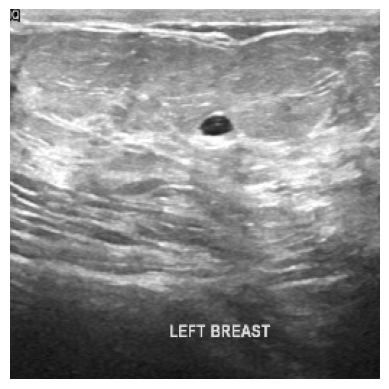

In [12]:
show_image(load_image(image_paths[0], SIZE))

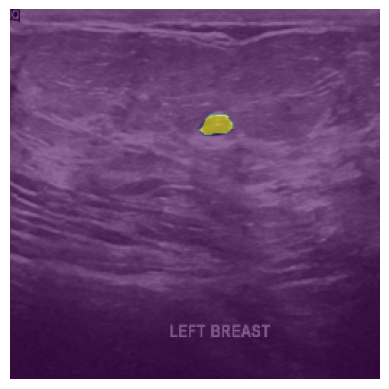

In [13]:
show_mask(load_image(image_paths[0], SIZE), load_image(mask_paths[0], SIZE)[:,:,0], alpha=0.6)

## **Data Work**

In [14]:
images = load_images(image_paths, SIZE)
masks = load_images(mask_paths, SIZE, mask=True)

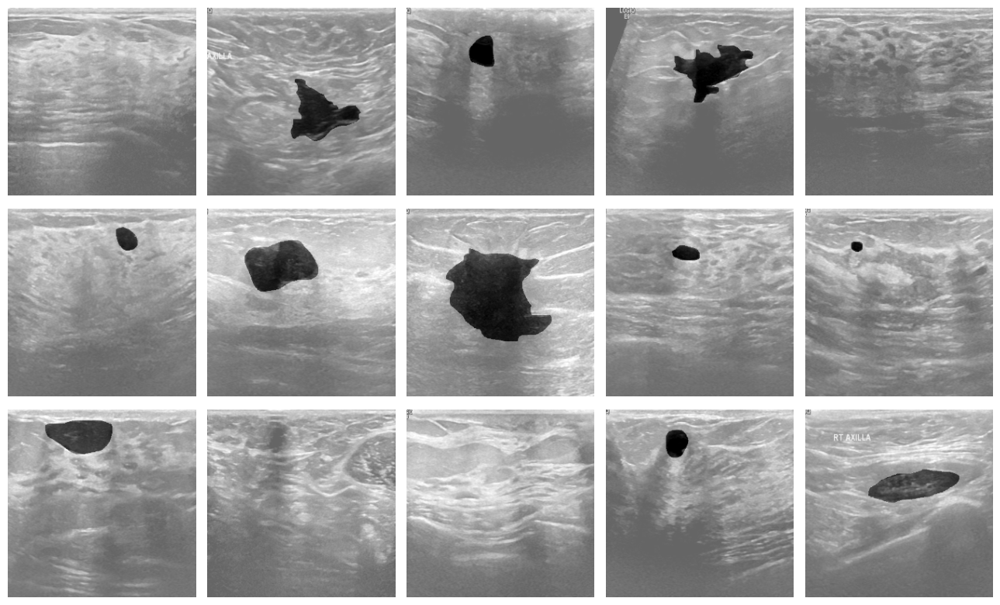

In [15]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='binary')
plt.tight_layout()
plt.show()

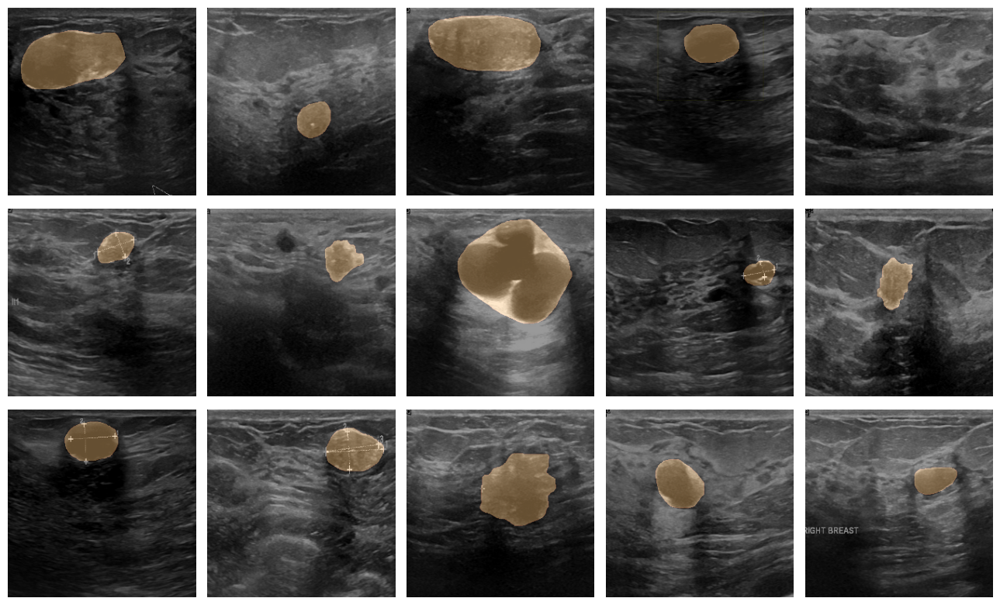

In [16]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='copper')
plt.tight_layout()
plt.show()

# **Encoder**

In [17]:
class EncoderBlock(Layer):

    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(EncoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate
        self.pooling = pooling

        #It consists of two convolutional layers with dropout and optional max pooling.
        self.c1 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.drop = Dropout(rate)
        self.c2 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.pool = MaxPool2D()

    # The call method performs forward pass and returns either the output
    # or both the output and the skipped input depending on the pooling parameter.
    def call(self, X):
        x = self.c1(X)
        x = self.drop(x)
        x = self.c2(x)
        if self.pooling:
            y = self.pool(x)
            return y, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
            'pooling':self.pooling
        }

# **Decoder**

In [18]:
class DecoderBlock(Layer):

    def __init__(self, filters, rate, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate

        self.up = UpSampling2D()
        self.net = EncoderBlock(filters, rate, pooling=False)

    def call(self, X):
        X, skip_X = X
        x = self.up(X)
        c_ = concatenate([x, skip_X])
        x = self.net(c_)
        return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
        }

# **Attention Gate**

In [19]:
class AttentionGate(Layer):

    def __init__(self, filters, bn, **kwargs):
        super(AttentionGate, self).__init__(**kwargs)

        self.filters = filters
        self.bn = bn

        self.normal = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer='he_normal')
        self.down = Conv2D(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.learn = Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')
        self.resample = UpSampling2D()
        self.BN = BatchNormalization()

    def call(self, X):
        X, skip_X = X

        x = self.normal(X)
        skip = self.down(skip_X)
        x = Add()([x, skip])
        x = self.learn(x)
        x = self.resample(x)
        f = Multiply()([x, skip_X])
        if self.bn:
            return self.BN(f)
        else:
            return f
        # return f

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "bn":self.bn
        }

# **Custom Callback**

In [20]:
def compute_guided_backpropagation(model, image):
    # Define GradientTape to record gradient operations
    with tf.GradientTape() as tape:
        # Watch the input image tensor
        tape.watch(image)
        # Perform a forward pass
        predictions = model(image)
    # Compute gradients of the output with respect to the input image
    gradients = tape.gradient(predictions, image)
    # Discard all negative gradients (set them to zero)
    gradients = tf.where(gradients > 0, gradients, tf.zeros_like(gradients))
    return gradients


class ShowProgress(Callback):
    def __init__(self, images, masks, model):
        self.images = images
        self.masks = masks
        self.model = model
        self.counter = 0

    def visualize_encoder_blocks(self, image):
        # Get the layers for the four Encoder Blocks
        encoder1_layer = self.model.get_layer("Encoder1")
        encoder2_layer = self.model.get_layer("Encoder2")
        encoder3_layer = self.model.get_layer("Encoder3")
        encoder4_layer = self.model.get_layer("Encoder4")

        image = np.expand_dims(image, axis=0)

        # Create subplots for visualization
        plt.figure(figsize=(14, 5))

        # Visualize the activations for each Encoder Block
        plt.subplot(1, 4, 1)
        plt.title("Encoder Block 1")
        activations = tf.keras.Model(inputs=self.model.inputs, outputs=encoder1_layer.output)(image)
        plt.imshow(activations[0][0, ..., 0], cmap='viridis')

        plt.subplot(1, 4, 2)
        plt.title("Encoder Block 2")
        activations = tf.keras.Model(inputs=self.model.inputs, outputs=encoder2_layer.output)(image)
        plt.imshow(activations[0][0, ..., 0], cmap='viridis')

        plt.subplot(1, 4, 3)
        plt.title("Encoder Block 3")
        activations = tf.keras.Model(inputs=self.model.inputs, outputs=encoder3_layer.output)(image)
        plt.imshow(activations[0][0, ..., 0], cmap='viridis')

        plt.subplot(1, 4, 4)
        plt.title("Encoder Block 4")
        activations = tf.keras.Model(inputs=self.model.inputs, outputs=encoder4_layer.output)(image)
        plt.imshow(activations[0][0, ..., 0], cmap='viridis')

        plt.tight_layout()
        plt.show()

    def visualize_gradcam(self, image, mask, pred_mask):
        # Initialize GradCAM explainer
        exp = GradCAM()

         # Use GradCAM to explain the image and obtain the gradient-weighted class activation map for each Attention layer
        cam1 = exp.explain(
            validation_data=(image[np.newaxis, ...], mask),
            class_index=1,
            layer_name='Attention1',
            model=self.model
        )
        cam2 = exp.explain(
            validation_data=(image[np.newaxis, ...], mask),
            class_index=1,
            layer_name='Attention2',
            model=self.model
        )
        cam3 = exp.explain(
            validation_data=(image[np.newaxis, ...], mask),
            class_index=1,
            layer_name='Attention3',
            model=self.model
        )
        cam4 = exp.explain(
            validation_data=(image[np.newaxis, ...], mask),
            class_index=1,
            layer_name='Attention4',
            model=self.model
        )

         # Visualize the GradCAM results

        plt.figure(figsize=(14,5))

        plt.subplot(1,4,1)
        show_image(cam1,title="GradCAM Attention1")

        plt.subplot(1,4,2)
        show_image(cam2,title="GradCAM Attention2")

        plt.subplot(1,4,3)
        show_image(cam3,title="GradCAM Attention3")

        plt.subplot(1,4,4)
        show_image(cam4,title="GradCAM Attention4")


        plt.tight_layout()
        plt.show()


    def visualize_saliency_maps_and_guided_backpropagation(self, image, mask, pred_mask):
        # Compute the gradients of the output with respect to the input image
        input_tensor = tf.convert_to_tensor(image[np.newaxis, ...], dtype=tf.float32)
        with tf.GradientTape() as tape:
            tape.watch(input_tensor)
            predictions = self.model(input_tensor)

        gradients = tape.gradient(predictions, input_tensor)
        gradients_abs = tf.abs(gradients)
        saliency_map = tf.reduce_max(gradients_abs, axis=-1)

        # Compute guided backpropagation gradients
        GBgradients = compute_guided_backpropagation(self.model, input_tensor)
        # Compute saliency map from guided backpropagation gradients
        GBsaliency_map = np.abs(GBgradients[0]).max(axis=-1)


        # Visualize the saliency map
        plt.figure(figsize=(14, 5))
        plt.subplot(1, 4, 1)
        plt.title("Original Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1, 4, 2)
        plt.title("Predicted Mask")
        show_mask(image, pred_mask, cmap='copper')

        plt.subplot(1, 4, 3)
        plt.title("Saliency Map")
        show_img(saliency_map, title="Saliency Map", cmap='hot', alpha=1)

        plt.subplot(1, 4, 4)
        plt.title("Guided Backpropagation")
        plt.imshow(GBsaliency_map, cmap='hot')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

    '''
    def visualize_guided_backpropagation(self, image, mask, pred_mask):
        # Convert the NumPy array to a TensorFlow tensor
        input_tensor = tf.convert_to_tensor(image[np.newaxis, ...], dtype=tf.float32)

        # Compute guided backpropagation gradients
        gradients = compute_guided_backpropagation(self.model, input_tensor)

        # Compute saliency map from guided backpropagation gradients
        saliency_map = np.abs(gradients[0]).max(axis=-1)

        # Visualize Guided Backpropagation
        plt.figure(figsize=(14, 5))

        plt.subplot(1, 3, 1)
        plt.title("Original Image")
        plt.imshow(image)
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.title("Original Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1, 3, 3)
        plt.title("Guided Backpropagation")
        plt.imshow(saliency_map, cmap='hot')
        plt.axis('off')

        plt.tight_layout()
        plt.show()
    '''


    def on_epoch_end(self, epoch, logs=None):
        self.counter += 1
        if self.counter % 10 == 0:
            # Reset counter
            self.counter = 0

            # Randomly select an index for an image
            id = np.random.randint(200)

            # Choose an image
            image = self.images[id]
            mask = self.masks[id]

            # Predict the mask using the model
            pred_mask = self.model.predict(image[np.newaxis, ...])

            # Visualize Encoder Blocks
            self.visualize_encoder_blocks(image)

            # Visualize Attention Gate GradCAM
            self.visualize_gradcam(image, mask, pred_mask)

            # Visualize Saliency Maps AND Guided Backpropagation
            self.visualize_saliency_maps_and_guided_backpropagation(image, mask, pred_mask)

# **Dice Metric**

In [21]:
def dice_coefficient(y_true, y_pred):
    smooth = 0.000001
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (2.0 * intersection + smooth) / (intersection + union + smooth)

# **IoU Metric**

In [22]:
def iou_coefficient(y_true, y_pred):
    smooth = 0.000001
    intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
    union = K.sum(y_true, axis=-1) + K.sum(y_pred, axis=-1) - intersection
    return (intersection + smooth) / (union + smooth)

# **Attention UNet**

In [23]:
# Custom contrast enhancement function using OpenCV
def enhance_contrast(image):
    # Convert the image to uint8
    image = (image * 255).astype(np.uint8)

    # Convert the image to LAB color space
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)

    # Split the LAB image into L, A, and B channels
    l, a, b = cv2.split(lab)

    # Apply CLAHE (Contrast Limited Adaptive Histogram Equalization) to the L channel
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)

    # Merge the enhanced L channel with the original A and B channels
    enhanced_lab = cv2.merge([cl, a, b])

    # Convert the LAB image back to RGB
    enhanced_image = cv2.cvtColor(enhanced_lab, cv2.COLOR_LAB2RGB)

    return enhanced_image

In [24]:
from tensorflow.keras.models import load_model
try:
    # Load model
    custom_objects = {'EncoderBlock': EncoderBlock, 'AttentionGate': AttentionGate, 'DecoderBlock': DecoderBlock}
    model = load_model('/content/drive/MyDrive/EndModelcp.h5', custom_objects=custom_objects)
    print("Successfully loaded previous model.")
except (OSError, IOError):
    # failed to load the model
    # Apply contrast enhancement to each image in the dataset
    enhanced_images = [enhance_contrast(image) for image in images]

    # Convert the list of enhanced images to a numpy array
    enhanced_images = np.array(enhanced_images)

    # Inputs from last 3 element
    # (batch_size, height, width, channels)
    input_layer = Input(shape=enhanced_images.shape[-3:])

    # Encoder
    # p1, p2, p3, and p4 represent the pooled features at each stage.
    # c1, c2, c3, and c4 represent the features before pooling,
    # which are used for skip connections in the decoder.
    p1, c1 = EncoderBlock(32,0.1, name="Encoder1")(input_layer)
    p2, c2 = EncoderBlock(64,0.1, name="Encoder2")(p1)
    p3, c3 = EncoderBlock(128,0.2, name="Encoder3")(p2)
    p4, c4 = EncoderBlock(256,0.2, name="Encoder4")(p3)

    # Encoding
    # This line defines an additional encoding block without pooling, resulting in the encoding tensor.
    encoding = EncoderBlock(512,0.3, pooling=False, name="Encoding")(p4)

    # Attention + Decoder

    a1 = AttentionGate(256, bn=True, name="Attention1")([encoding, c4])
    d1 = DecoderBlock(256,0.2, name="Decoder1")([encoding, a1])

    a2 = AttentionGate(128, bn=True, name="Attention2")([d1, c3])
    d2 = DecoderBlock(128,0.2, name="Decoder2")([d1, a2])

    a3 = AttentionGate(64, bn=True, name="Attention3")([d2, c2])
    d3 = DecoderBlock(64,0.1, name="Decoder3")([d2, a3])


    a4 = AttentionGate(32, bn=True, name="Attention4")([d3, c1])
    d4 = DecoderBlock(32,0.1, name="Decoder4")([d3, a4])

    # Output
    # The output layer with a convolutional layer having one filter, using the sigmoid activation function.
    # It produces the final segmentation mask.
    output_layer = Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(d4)

    # Model
    model = Model(
        inputs=[input_layer],
        outputs=[output_layer]
    )

    # Compile
    model.compile(
        loss='binary_crossentropy',
        optimizer='adam',
        metrics=['accuracy', MeanIoU(num_classes=2, name='IoU')]
    )

    print("create new model succesfully")


create new model succesfully


In [25]:
# Callbacks
# saves the model's weights to a file during training
cb = [
    # EarlyStopping(patience=3, restore_best_weight=True), # With Segmentation I trust on eyes rather than on metrics
    ModelCheckpoint('/content/drive/MyDrive/AttentionCustomUNetcp.h5', save_best_only=True),
    ShowProgress(images, masks, model)
]

# **Training**

Epoch 1/200
97/97 [==============================] - ETA: 0s - loss: 0.3458 - accuracy: 0.8994 - IoU: 0.4546

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


97/97 [==============================] - 40s 193ms/step - loss: 0.3458 - accuracy: 0.8994 - IoU: 0.4546 - val_loss: 0.1754 - val_accuracy: 0.9813 - val_IoU: 0.4909
Epoch 2/200
97/97 [==============================] - 10s 101ms/step - loss: 0.2340 - accuracy: 0.9098 - IoU: 0.4540 - val_loss: 0.0912 - val_accuracy: 0.9813 - val_IoU: 0.4909
Epoch 3/200
97/97 [==============================] - 9s 92ms/step - loss: 0.2216 - accuracy: 0.9170 - IoU: 0.4564 - val_loss: 0.0931 - val_accuracy: 0.9813 - val_IoU: 0.4909
Epoch 4/200
97/97 [==============================] - 11s 111ms/step - loss: 0.2116 - accuracy: 0.9215 - IoU: 0.4537 - val_loss: 0.0698 - val_accuracy: 0.9826 - val_IoU: 0.4909
Epoch 5/200
97/97 [==============================] - 9s 95ms/step - loss: 0.1994 - accuracy: 0.9269 - IoU: 0.4545 - val_loss: 0.0883 - val_accuracy: 0.9813 - val_IoU: 0.4909
Epoch 6/200
97/97 [==============================] - 9s 94ms/step - loss: 0.1908 - accuracy: 0.9286 - IoU: 0.4552 - val_loss: 0.0889 - v

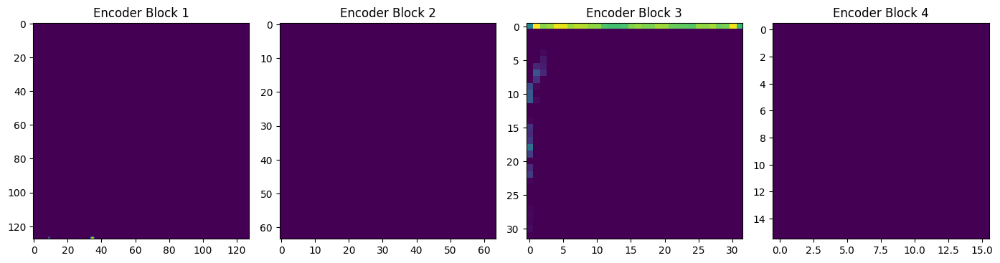

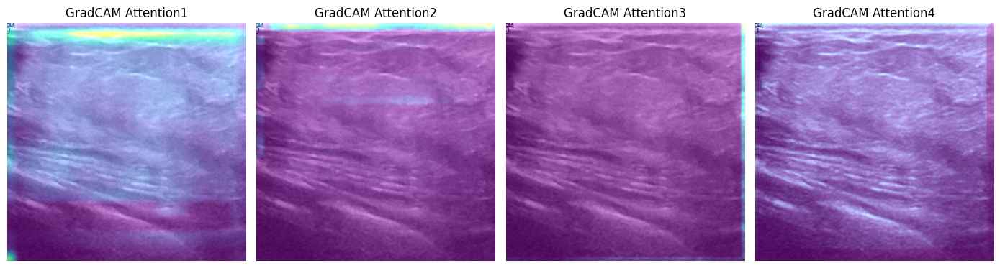

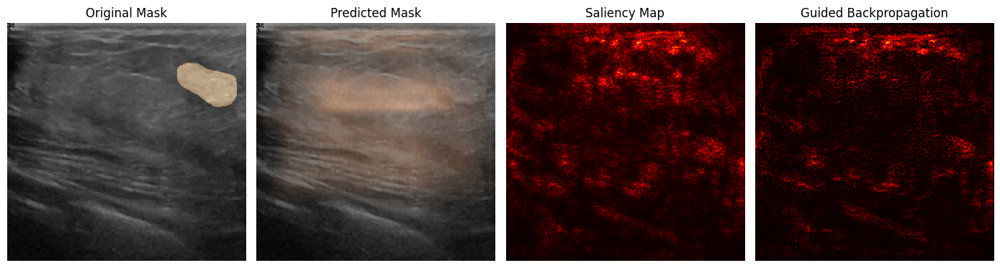

97/97 [==============================] - 18s 186ms/step - loss: 0.1531 - accuracy: 0.9445 - IoU: 0.4559 - val_loss: 0.0666 - val_accuracy: 0.9841 - val_IoU: 0.4909
Epoch 11/200
97/97 [==============================] - 9s 97ms/step - loss: 0.1594 - accuracy: 0.9429 - IoU: 0.4534 - val_loss: 0.0862 - val_accuracy: 0.9856 - val_IoU: 0.4909
Epoch 12/200
97/97 [==============================] - 9s 97ms/step - loss: 0.1532 - accuracy: 0.9439 - IoU: 0.4556 - val_loss: 0.0667 - val_accuracy: 0.9837 - val_IoU: 0.4909
Epoch 13/200
97/97 [==============================] - 9s 95ms/step - loss: 0.1431 - accuracy: 0.9473 - IoU: 0.4549 - val_loss: 0.0726 - val_accuracy: 0.9853 - val_IoU: 0.4909
Epoch 14/200
97/97 [==============================] - 11s 117ms/step - loss: 0.1316 - accuracy: 0.9520 - IoU: 0.4556 - val_loss: 0.0545 - val_accuracy: 0.9857 - val_IoU: 0.4909
Epoch 15/200
97/97 [==============================] - 9s 96ms/step - loss: 0.1335 - accuracy: 0.9510 - IoU: 0.4557 - val_loss: 0.0551 

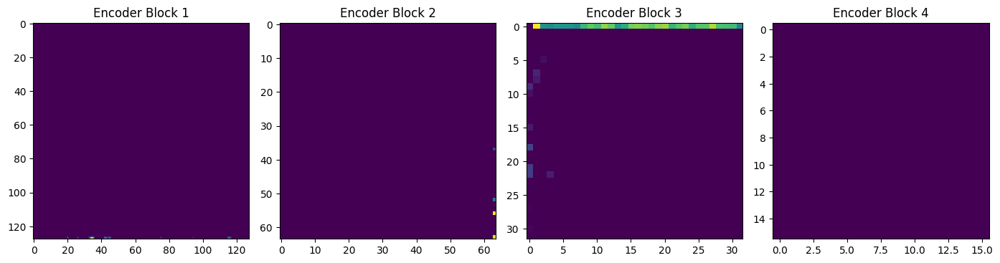

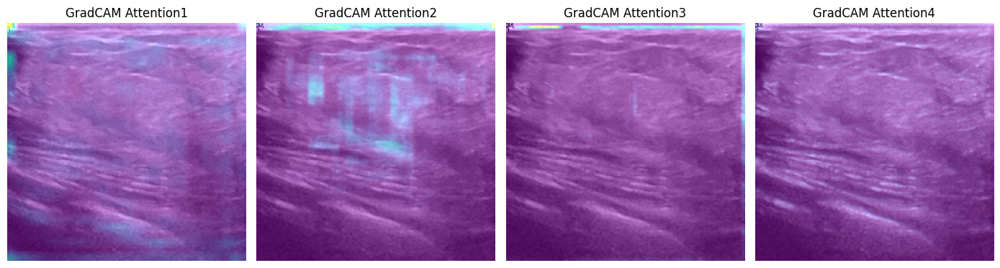

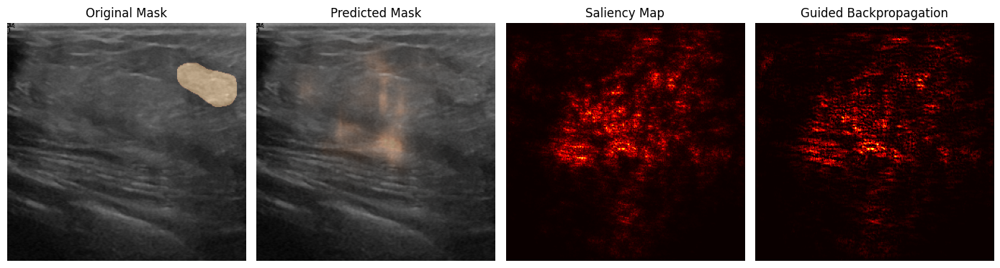

97/97 [==============================] - 13s 134ms/step - loss: 0.1090 - accuracy: 0.9589 - IoU: 0.4587 - val_loss: 0.0614 - val_accuracy: 0.9849 - val_IoU: 0.4909
Epoch 21/200
97/97 [==============================] - 9s 95ms/step - loss: 0.1000 - accuracy: 0.9621 - IoU: 0.4566 - val_loss: 0.0723 - val_accuracy: 0.9749 - val_IoU: 0.4909
Epoch 22/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0933 - accuracy: 0.9643 - IoU: 0.4585 - val_loss: 0.0648 - val_accuracy: 0.9772 - val_IoU: 0.4909
Epoch 23/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0875 - accuracy: 0.9662 - IoU: 0.4613 - val_loss: 0.0831 - val_accuracy: 0.9703 - val_IoU: 0.4909
Epoch 24/200
97/97 [==============================] - 9s 93ms/step - loss: 0.0889 - accuracy: 0.9652 - IoU: 0.4627 - val_loss: 0.1036 - val_accuracy: 0.9595 - val_IoU: 0.4910
Epoch 25/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0780 - accuracy: 0.9695 - IoU: 0.4632 - val_loss: 0.0599 - 

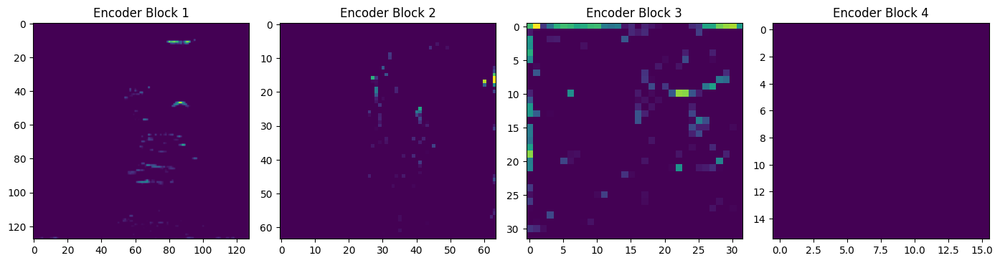

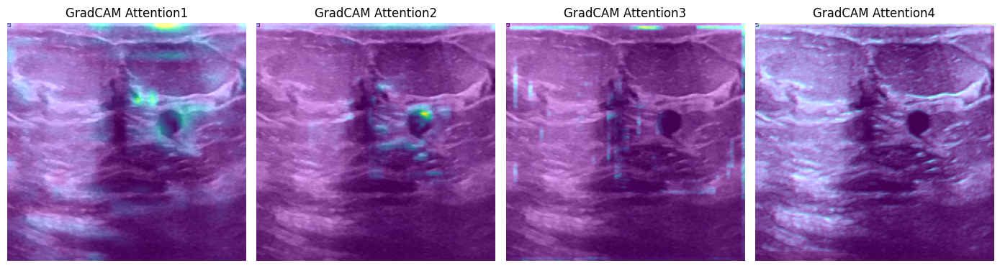

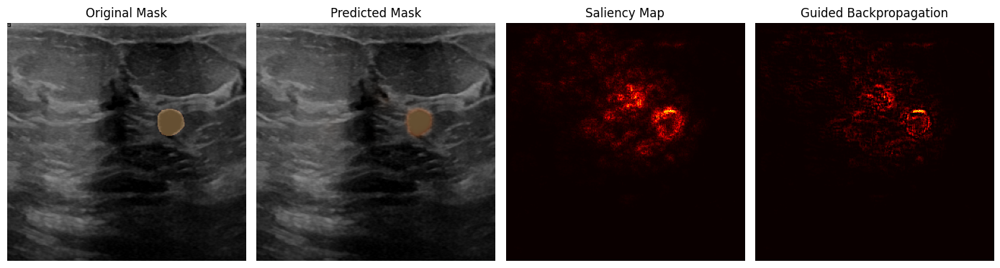

97/97 [==============================] - 13s 130ms/step - loss: 0.0656 - accuracy: 0.9738 - IoU: 0.4811 - val_loss: 0.0613 - val_accuracy: 0.9813 - val_IoU: 0.4916
Epoch 31/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0627 - accuracy: 0.9747 - IoU: 0.4790 - val_loss: 0.0595 - val_accuracy: 0.9811 - val_IoU: 0.4913
Epoch 32/200
97/97 [==============================] - 9s 93ms/step - loss: 0.0568 - accuracy: 0.9766 - IoU: 0.4923 - val_loss: 0.0573 - val_accuracy: 0.9852 - val_IoU: 0.4909
Epoch 33/200
97/97 [==============================] - 9s 93ms/step - loss: 0.0564 - accuracy: 0.9772 - IoU: 0.4888 - val_loss: 0.0809 - val_accuracy: 0.9725 - val_IoU: 0.4955
Epoch 34/200
97/97 [==============================] - 9s 93ms/step - loss: 0.0513 - accuracy: 0.9787 - IoU: 0.4983 - val_loss: 0.0601 - val_accuracy: 0.9840 - val_IoU: 0.4911
Epoch 35/200
97/97 [==============================] - 9s 94ms/step - loss: 0.0477 - accuracy: 0.9802 - IoU: 0.4917 - val_loss: 0.0659 - 

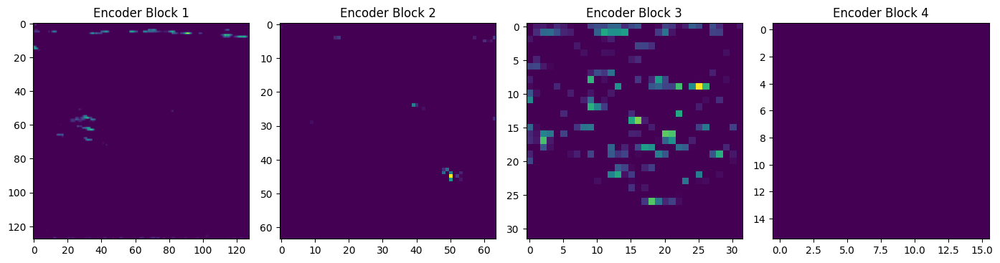

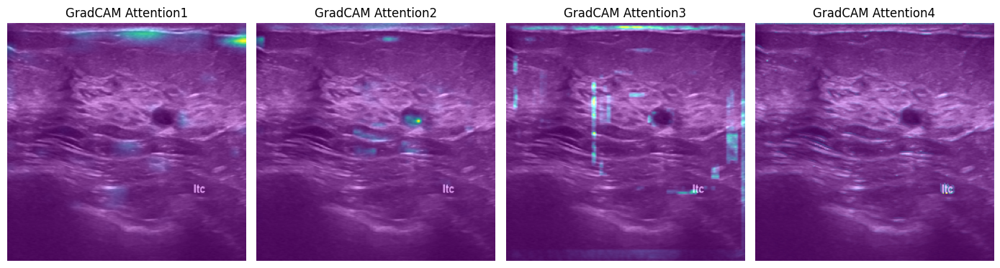

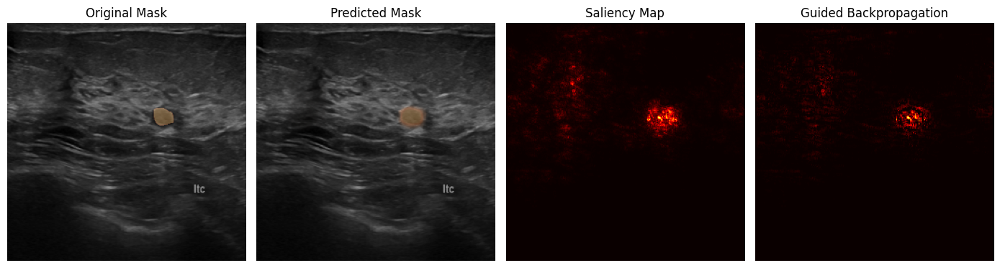

97/97 [==============================] - 12s 124ms/step - loss: 0.0427 - accuracy: 0.9817 - IoU: 0.4979 - val_loss: 0.0737 - val_accuracy: 0.9755 - val_IoU: 0.4920
Epoch 41/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0454 - accuracy: 0.9812 - IoU: 0.4947 - val_loss: 0.0656 - val_accuracy: 0.9766 - val_IoU: 0.4910
Epoch 42/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0455 - accuracy: 0.9810 - IoU: 0.4839 - val_loss: 0.0705 - val_accuracy: 0.9801 - val_IoU: 0.4933
Epoch 43/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0554 - accuracy: 0.9777 - IoU: 0.4887 - val_loss: 0.0636 - val_accuracy: 0.9810 - val_IoU: 0.4909
Epoch 44/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0514 - accuracy: 0.9792 - IoU: 0.4788 - val_loss: 0.0728 - val_accuracy: 0.9831 - val_IoU: 0.4911
Epoch 45/200
97/97 [==============================] - 9s 94ms/step - loss: 0.0399 - accuracy: 0.9831 - IoU: 0.5053 - val_loss: 0.0734 - 

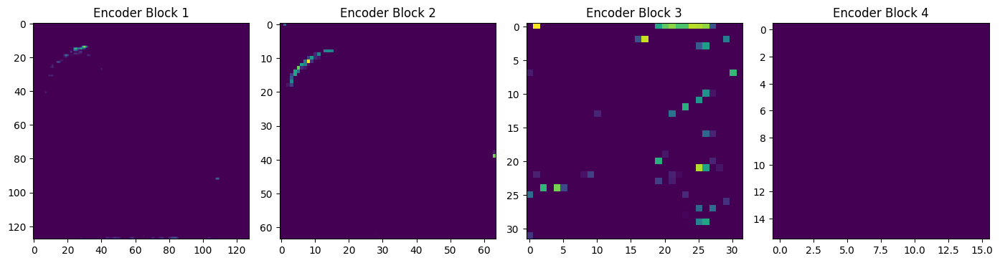

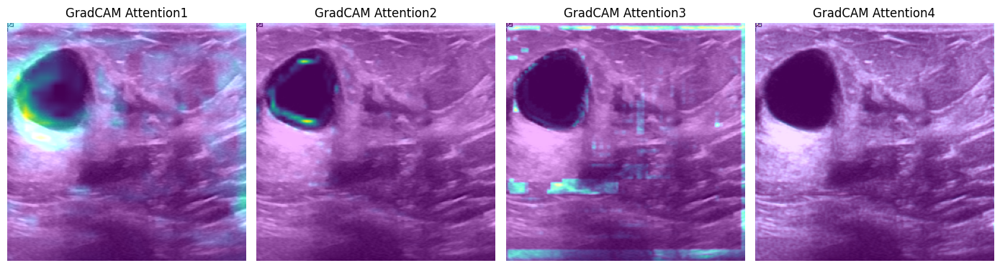

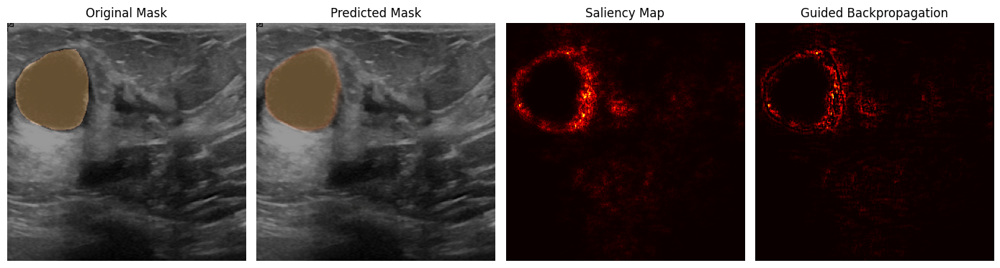

97/97 [==============================] - 13s 132ms/step - loss: 0.0339 - accuracy: 0.9849 - IoU: 0.5151 - val_loss: 0.0766 - val_accuracy: 0.9775 - val_IoU: 0.4976
Epoch 51/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0335 - accuracy: 0.9851 - IoU: 0.5145 - val_loss: 0.0719 - val_accuracy: 0.9785 - val_IoU: 0.4925
Epoch 52/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0304 - accuracy: 0.9864 - IoU: 0.5139 - val_loss: 0.0752 - val_accuracy: 0.9827 - val_IoU: 0.4919
Epoch 53/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0293 - accuracy: 0.9865 - IoU: 0.5112 - val_loss: 0.0669 - val_accuracy: 0.9835 - val_IoU: 0.4909
Epoch 54/200
97/97 [==============================] - 9s 93ms/step - loss: 0.0335 - accuracy: 0.9853 - IoU: 0.5116 - val_loss: 0.0753 - val_accuracy: 0.9773 - val_IoU: 0.5242
Epoch 55/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0339 - accuracy: 0.9849 - IoU: 0.5164 - val_loss: 0.0727 - 

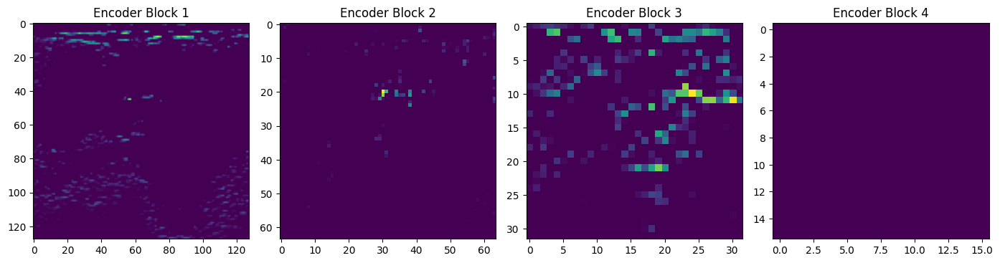

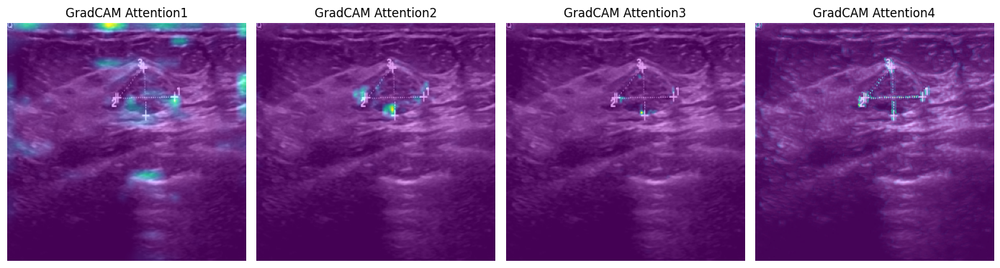

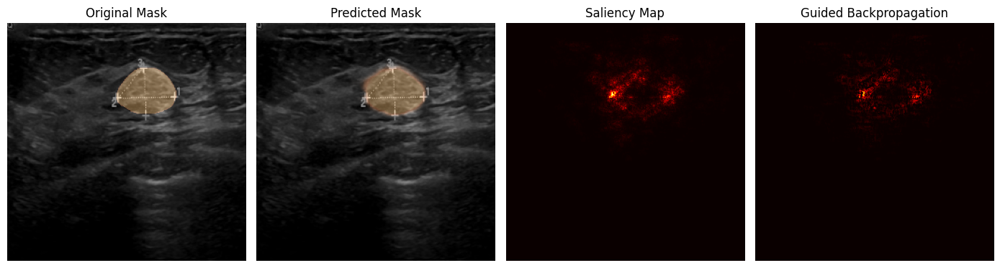

97/97 [==============================] - 12s 124ms/step - loss: 0.0275 - accuracy: 0.9876 - IoU: 0.5670 - val_loss: 0.0913 - val_accuracy: 0.9769 - val_IoU: 0.5295
Epoch 61/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0230 - accuracy: 0.9890 - IoU: 0.5780 - val_loss: 0.1006 - val_accuracy: 0.9759 - val_IoU: 0.5339
Epoch 62/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0212 - accuracy: 0.9898 - IoU: 0.5825 - val_loss: 0.0956 - val_accuracy: 0.9793 - val_IoU: 0.5203
Epoch 63/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0209 - accuracy: 0.9897 - IoU: 0.5680 - val_loss: 0.0866 - val_accuracy: 0.9817 - val_IoU: 0.5108
Epoch 64/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0207 - accuracy: 0.9899 - IoU: 0.5855 - val_loss: 0.0931 - val_accuracy: 0.9810 - val_IoU: 0.5140
Epoch 65/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0197 - accuracy: 0.9901 - IoU: 0.6047 - val_loss: 0.0879 - 

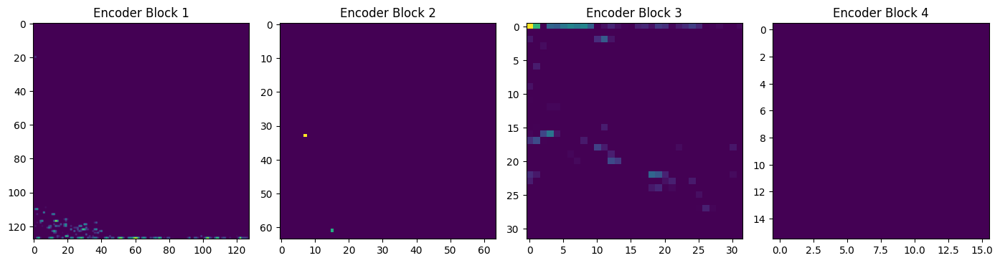

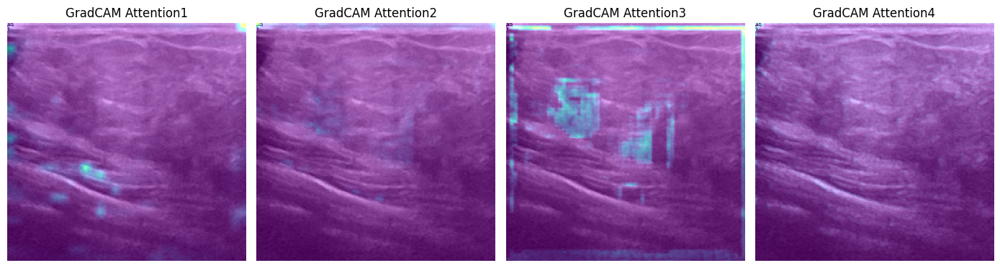

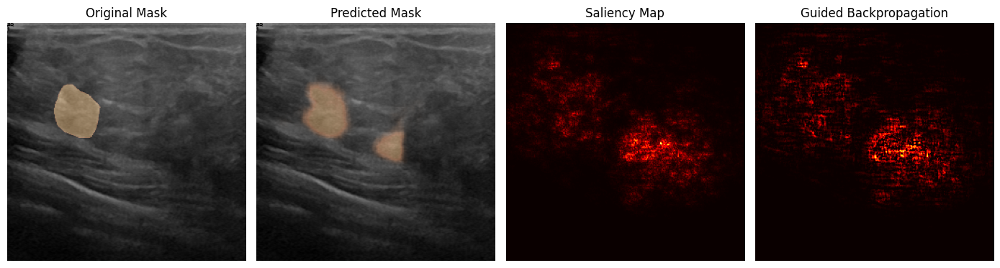

97/97 [==============================] - 13s 135ms/step - loss: 0.0370 - accuracy: 0.9843 - IoU: 0.4969 - val_loss: 0.1233 - val_accuracy: 0.9691 - val_IoU: 0.5040
Epoch 71/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0286 - accuracy: 0.9870 - IoU: 0.5145 - val_loss: 0.0786 - val_accuracy: 0.9847 - val_IoU: 0.4914
Epoch 72/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0226 - accuracy: 0.9891 - IoU: 0.5350 - val_loss: 0.0867 - val_accuracy: 0.9835 - val_IoU: 0.4987
Epoch 73/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0214 - accuracy: 0.9896 - IoU: 0.5408 - val_loss: 0.0813 - val_accuracy: 0.9857 - val_IoU: 0.4909
Epoch 74/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0217 - accuracy: 0.9893 - IoU: 0.5487 - val_loss: 0.0734 - val_accuracy: 0.9821 - val_IoU: 0.4940
Epoch 75/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0212 - accuracy: 0.9896 - IoU: 0.5618 - val_loss: 0.0932 - 

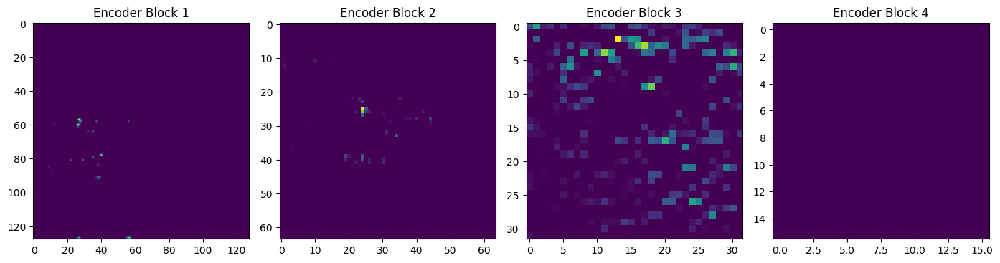

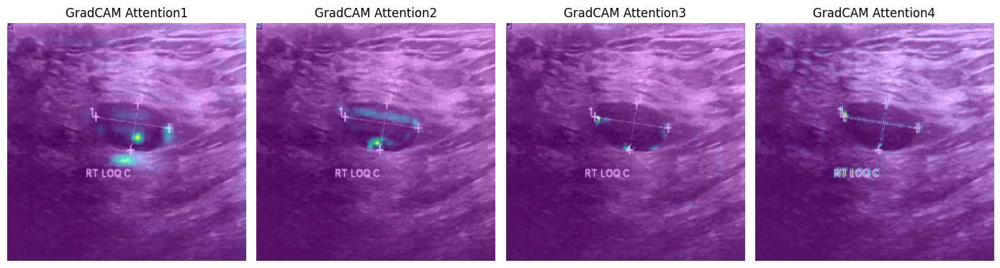

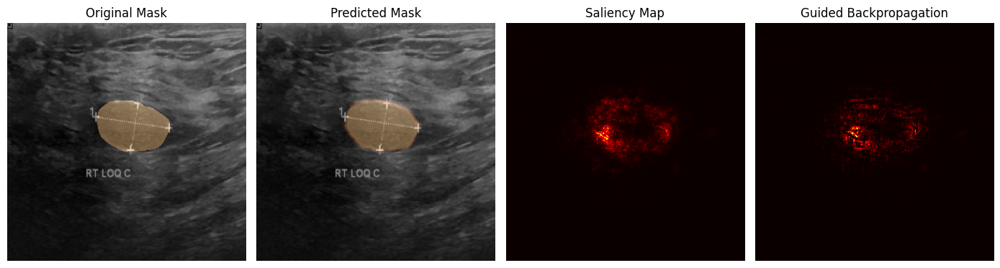

97/97 [==============================] - 14s 140ms/step - loss: 0.0202 - accuracy: 0.9903 - IoU: 0.5609 - val_loss: 0.0842 - val_accuracy: 0.9809 - val_IoU: 0.5066
Epoch 81/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0259 - accuracy: 0.9884 - IoU: 0.5418 - val_loss: 0.0975 - val_accuracy: 0.9788 - val_IoU: 0.5134
Epoch 82/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0271 - accuracy: 0.9878 - IoU: 0.5408 - val_loss: 0.0755 - val_accuracy: 0.9850 - val_IoU: 0.4986
Epoch 83/200
97/97 [==============================] - 9s 98ms/step - loss: 0.0219 - accuracy: 0.9895 - IoU: 0.5454 - val_loss: 0.0808 - val_accuracy: 0.9837 - val_IoU: 0.4959
Epoch 84/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0329 - accuracy: 0.9863 - IoU: 0.5169 - val_loss: 0.0772 - val_accuracy: 0.9777 - val_IoU: 0.4909
Epoch 85/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0416 - accuracy: 0.9828 - IoU: 0.4839 - val_loss: 0.0943 - 

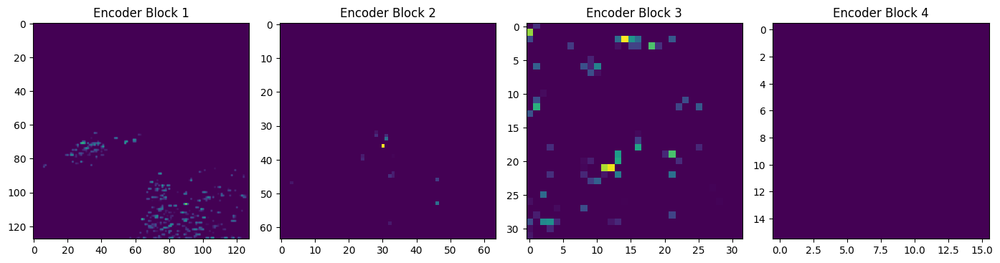

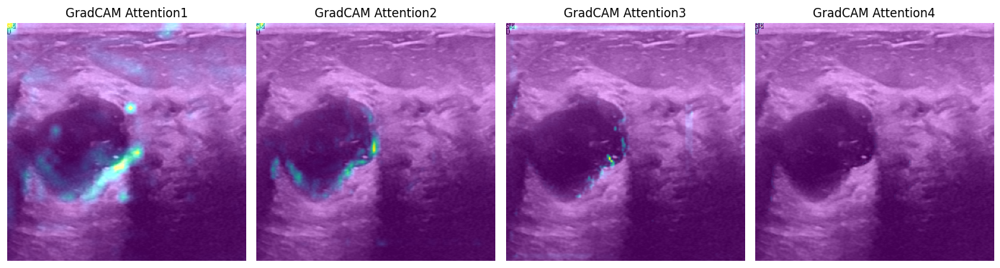

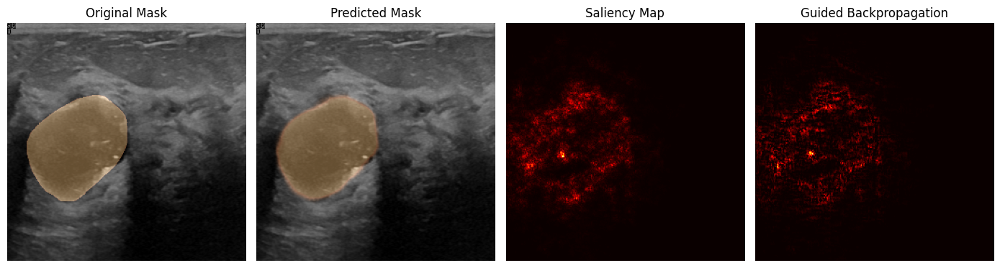

97/97 [==============================] - 14s 141ms/step - loss: 0.0159 - accuracy: 0.9918 - IoU: 0.6186 - val_loss: 0.0986 - val_accuracy: 0.9847 - val_IoU: 0.5240
Epoch 91/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0149 - accuracy: 0.9921 - IoU: 0.6423 - val_loss: 0.0968 - val_accuracy: 0.9838 - val_IoU: 0.5237
Epoch 92/200
97/97 [==============================] - 9s 98ms/step - loss: 0.0141 - accuracy: 0.9925 - IoU: 0.6481 - val_loss: 0.0969 - val_accuracy: 0.9844 - val_IoU: 0.5267
Epoch 93/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0138 - accuracy: 0.9925 - IoU: 0.6610 - val_loss: 0.1133 - val_accuracy: 0.9848 - val_IoU: 0.5315
Epoch 94/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0142 - accuracy: 0.9925 - IoU: 0.6554 - val_loss: 0.0975 - val_accuracy: 0.9823 - val_IoU: 0.5298
Epoch 95/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0145 - accuracy: 0.9922 - IoU: 0.6539 - val_loss: 0.0980 - 

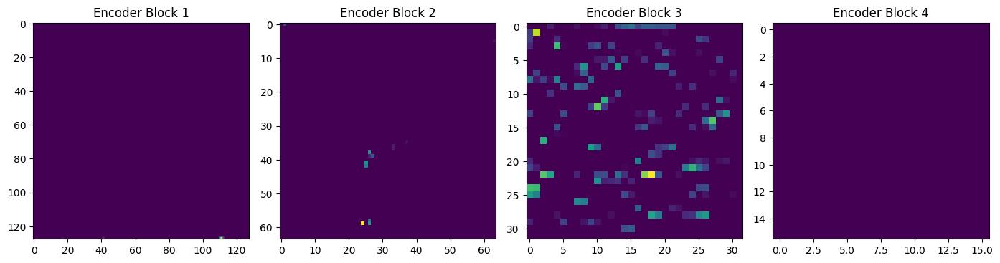

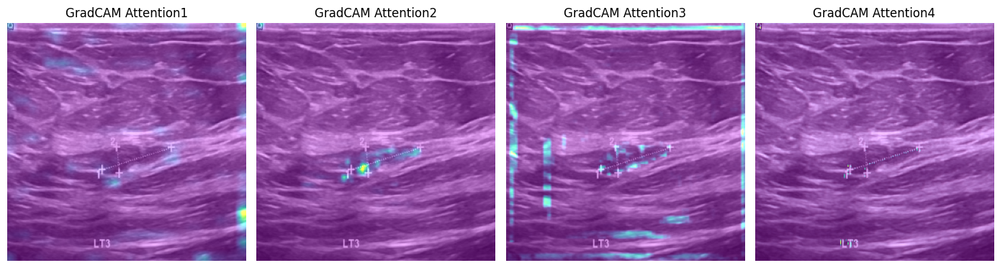

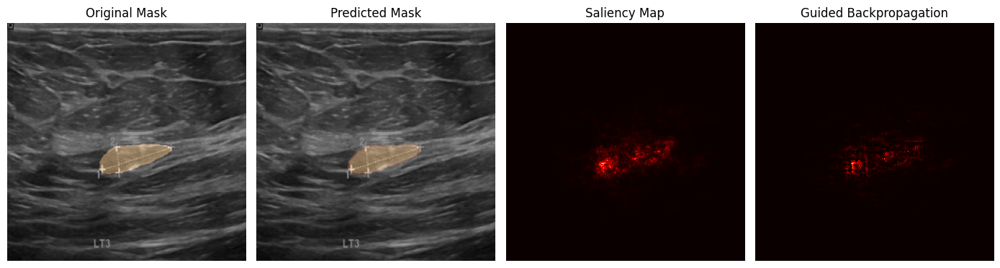

97/97 [==============================] - 14s 143ms/step - loss: 0.0136 - accuracy: 0.9927 - IoU: 0.6754 - val_loss: 0.1111 - val_accuracy: 0.9826 - val_IoU: 0.5333
Epoch 101/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0162 - accuracy: 0.9919 - IoU: 0.5518 - val_loss: 0.1012 - val_accuracy: 0.9747 - val_IoU: 0.5063
Epoch 102/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0434 - accuracy: 0.9838 - IoU: 0.5018 - val_loss: 0.1489 - val_accuracy: 0.9423 - val_IoU: 0.4947
Epoch 103/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0546 - accuracy: 0.9791 - IoU: 0.4797 - val_loss: 0.0737 - val_accuracy: 0.9856 - val_IoU: 0.4912
Epoch 104/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0359 - accuracy: 0.9850 - IoU: 0.5079 - val_loss: 0.0772 - val_accuracy: 0.9699 - val_IoU: 0.4909
Epoch 105/200
97/97 [==============================] - 9s 94ms/step - loss: 0.0293 - accuracy: 0.9871 - IoU: 0.5002 - val_loss: 0.07

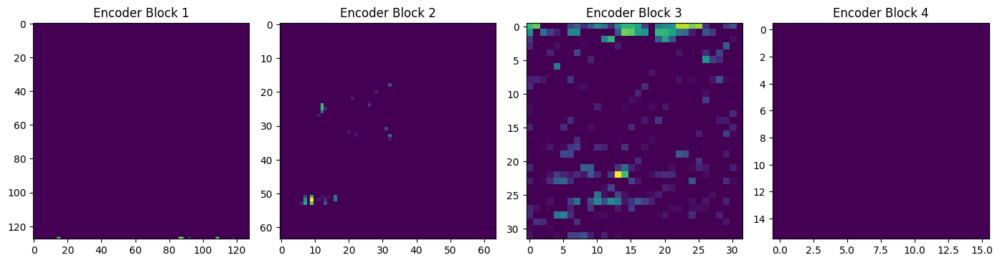

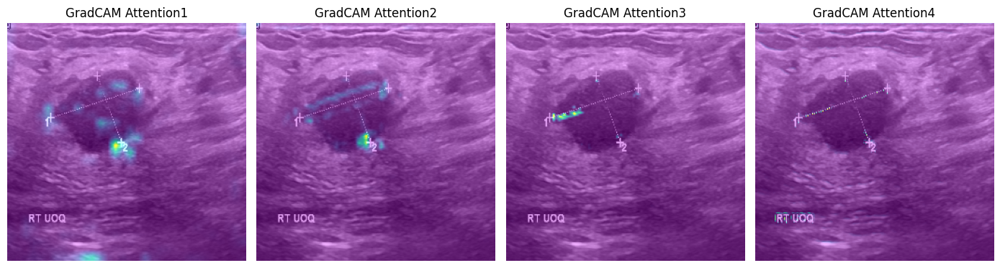

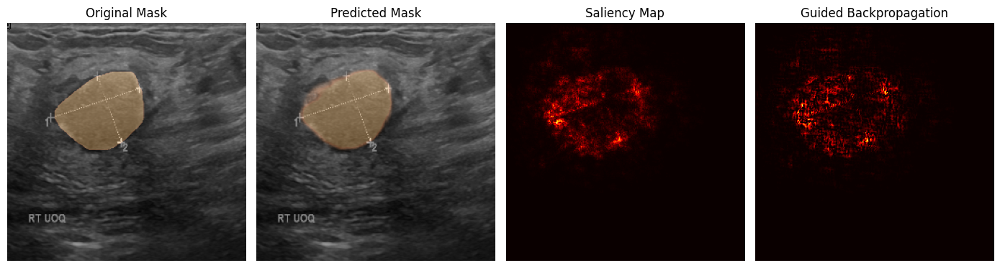

97/97 [==============================] - 13s 138ms/step - loss: 0.0146 - accuracy: 0.9923 - IoU: 0.5842 - val_loss: 0.0941 - val_accuracy: 0.9835 - val_IoU: 0.5120
Epoch 111/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0137 - accuracy: 0.9927 - IoU: 0.6166 - val_loss: 0.1001 - val_accuracy: 0.9836 - val_IoU: 0.5137
Epoch 112/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0135 - accuracy: 0.9927 - IoU: 0.6263 - val_loss: 0.1042 - val_accuracy: 0.9835 - val_IoU: 0.5171
Epoch 113/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0127 - accuracy: 0.9931 - IoU: 0.6288 - val_loss: 0.1019 - val_accuracy: 0.9831 - val_IoU: 0.5194
Epoch 114/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0125 - accuracy: 0.9929 - IoU: 0.6331 - val_loss: 0.0948 - val_accuracy: 0.9833 - val_IoU: 0.5254
Epoch 115/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0129 - accuracy: 0.9930 - IoU: 0.6419 - val_loss: 0.09

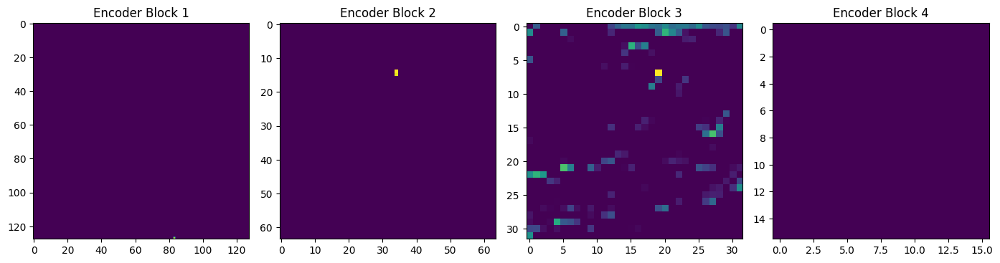

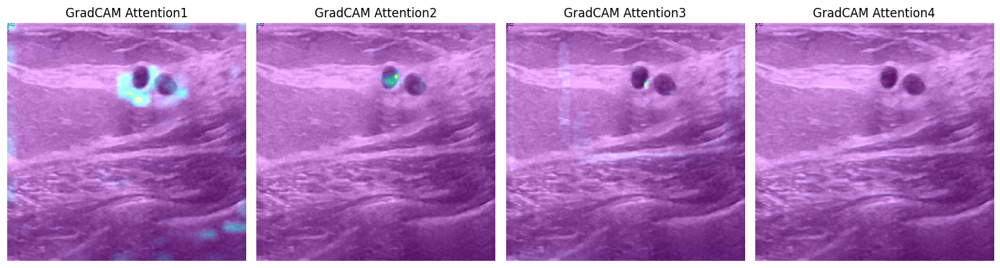

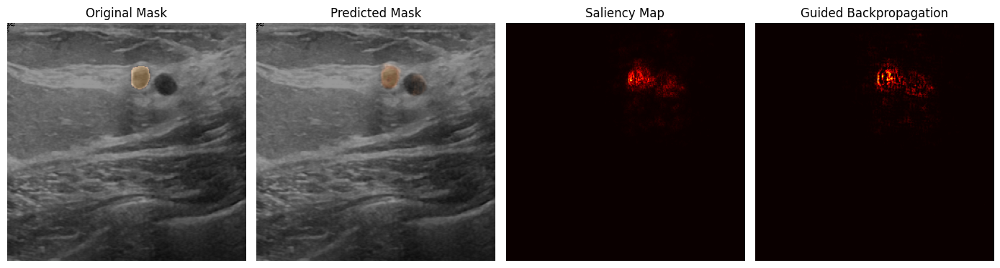

97/97 [==============================] - 13s 135ms/step - loss: 0.0338 - accuracy: 0.9860 - IoU: 0.5046 - val_loss: 0.0821 - val_accuracy: 0.9821 - val_IoU: 0.4910
Epoch 121/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0309 - accuracy: 0.9866 - IoU: 0.5087 - val_loss: 0.0714 - val_accuracy: 0.9819 - val_IoU: 0.5182
Epoch 122/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0217 - accuracy: 0.9898 - IoU: 0.5587 - val_loss: 0.0831 - val_accuracy: 0.9835 - val_IoU: 0.5098
Epoch 123/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0236 - accuracy: 0.9893 - IoU: 0.5386 - val_loss: 0.0873 - val_accuracy: 0.9804 - val_IoU: 0.4951
Epoch 124/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0178 - accuracy: 0.9911 - IoU: 0.5703 - val_loss: 0.0882 - val_accuracy: 0.9835 - val_IoU: 0.5092
Epoch 125/200
97/97 [==============================] - 9s 98ms/step - loss: 0.0143 - accuracy: 0.9925 - IoU: 0.6002 - val_loss: 0.10

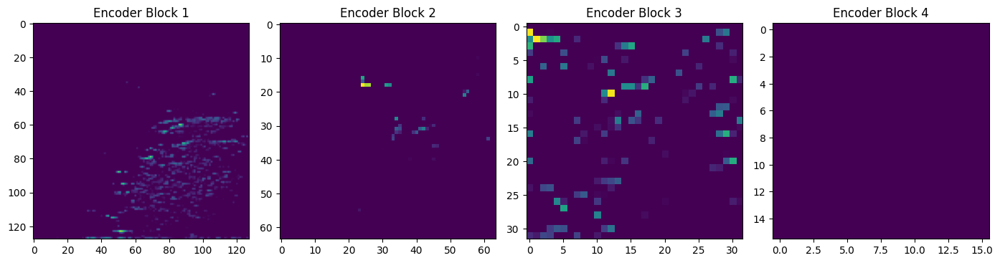

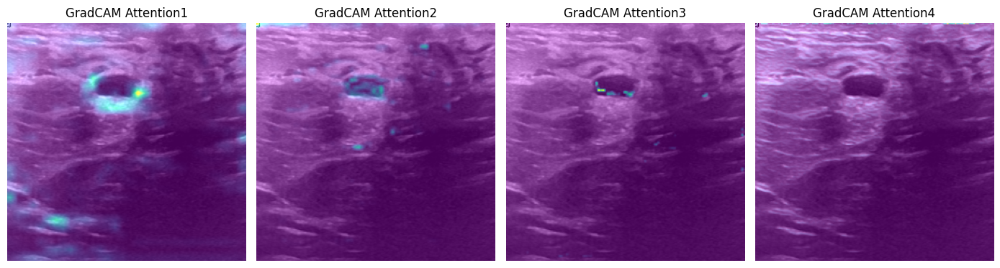

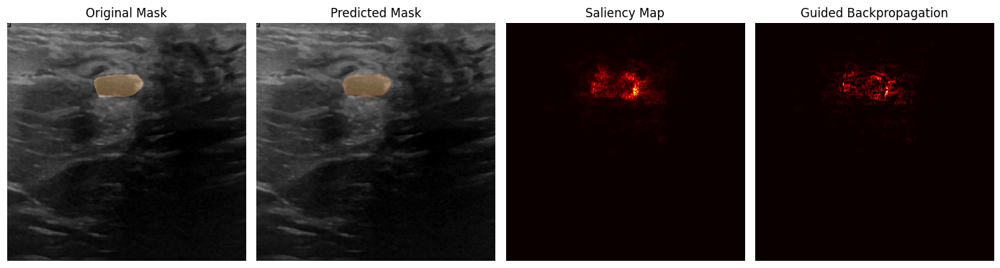

97/97 [==============================] - 14s 146ms/step - loss: 0.0114 - accuracy: 0.9936 - IoU: 0.6467 - val_loss: 0.1017 - val_accuracy: 0.9836 - val_IoU: 0.5222
Epoch 131/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0111 - accuracy: 0.9936 - IoU: 0.6535 - val_loss: 0.1065 - val_accuracy: 0.9834 - val_IoU: 0.5312
Epoch 132/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0126 - accuracy: 0.9931 - IoU: 0.6318 - val_loss: 0.0972 - val_accuracy: 0.9833 - val_IoU: 0.5420
Epoch 133/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0133 - accuracy: 0.9930 - IoU: 0.6300 - val_loss: 0.1096 - val_accuracy: 0.9835 - val_IoU: 0.5275
Epoch 134/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0121 - accuracy: 0.9932 - IoU: 0.6545 - val_loss: 0.1104 - val_accuracy: 0.9835 - val_IoU: 0.5217
Epoch 135/200
97/97 [==============================] - 10s 99ms/step - loss: 0.0123 - accuracy: 0.9934 - IoU: 0.6245 - val_loss: 0.0

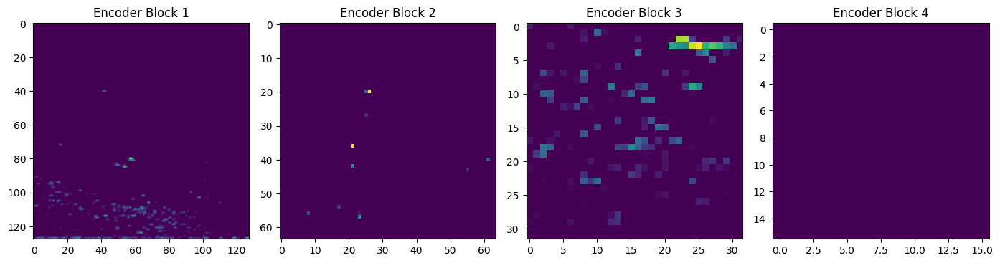

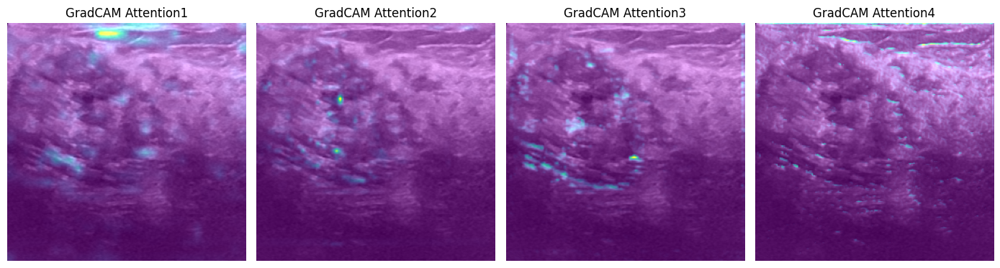

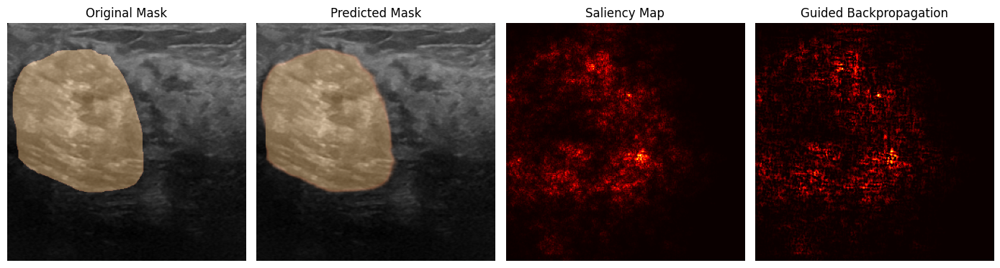

97/97 [==============================] - 14s 142ms/step - loss: 0.0104 - accuracy: 0.9940 - IoU: 0.6999 - val_loss: 0.1047 - val_accuracy: 0.9839 - val_IoU: 0.5333
Epoch 141/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0109 - accuracy: 0.9939 - IoU: 0.6765 - val_loss: 0.1027 - val_accuracy: 0.9847 - val_IoU: 0.5249
Epoch 142/200
97/97 [==============================] - 9s 98ms/step - loss: 0.0102 - accuracy: 0.9941 - IoU: 0.6918 - val_loss: 0.0979 - val_accuracy: 0.9853 - val_IoU: 0.5313
Epoch 143/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0102 - accuracy: 0.9939 - IoU: 0.6913 - val_loss: 0.1105 - val_accuracy: 0.9840 - val_IoU: 0.5496
Epoch 144/200
97/97 [==============================] - 10s 98ms/step - loss: 0.0098 - accuracy: 0.9942 - IoU: 0.7009 - val_loss: 0.1160 - val_accuracy: 0.9840 - val_IoU: 0.5357
Epoch 145/200
97/97 [==============================] - 10s 98ms/step - loss: 0.0095 - accuracy: 0.9944 - IoU: 0.7161 - val_loss: 0.

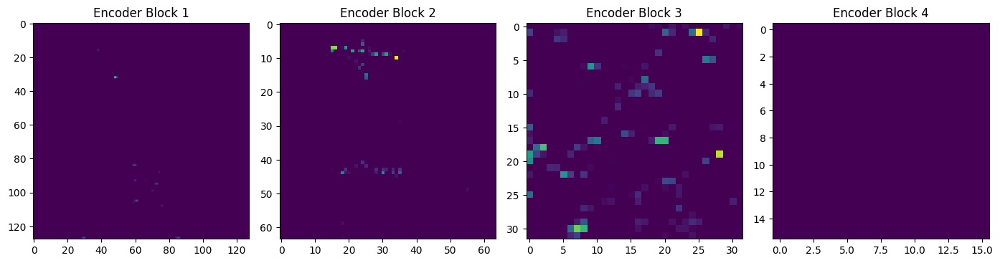

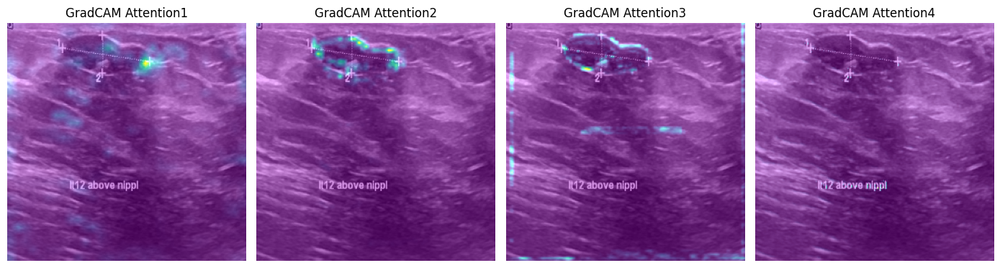

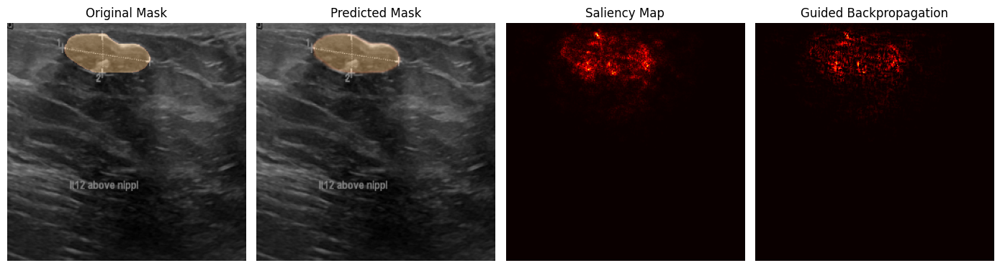

97/97 [==============================] - 13s 137ms/step - loss: 0.0154 - accuracy: 0.9922 - IoU: 0.5608 - val_loss: 0.1006 - val_accuracy: 0.9848 - val_IoU: 0.5000
Epoch 151/200
97/97 [==============================] - 9s 95ms/step - loss: 0.0145 - accuracy: 0.9923 - IoU: 0.5593 - val_loss: 0.0891 - val_accuracy: 0.9832 - val_IoU: 0.4984
Epoch 152/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0128 - accuracy: 0.9930 - IoU: 0.5931 - val_loss: 0.0978 - val_accuracy: 0.9854 - val_IoU: 0.5093
Epoch 153/200
97/97 [==============================] - 9s 96ms/step - loss: 0.0119 - accuracy: 0.9934 - IoU: 0.6183 - val_loss: 0.0967 - val_accuracy: 0.9857 - val_IoU: 0.5110
Epoch 154/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0109 - accuracy: 0.9939 - IoU: 0.6201 - val_loss: 0.1027 - val_accuracy: 0.9847 - val_IoU: 0.5113
Epoch 155/200
97/97 [==============================] - 9s 97ms/step - loss: 0.0109 - accuracy: 0.9938 - IoU: 0.6414 - val_loss: 0.10

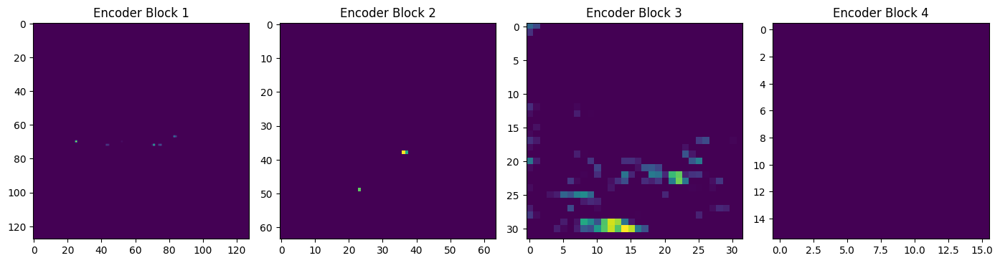

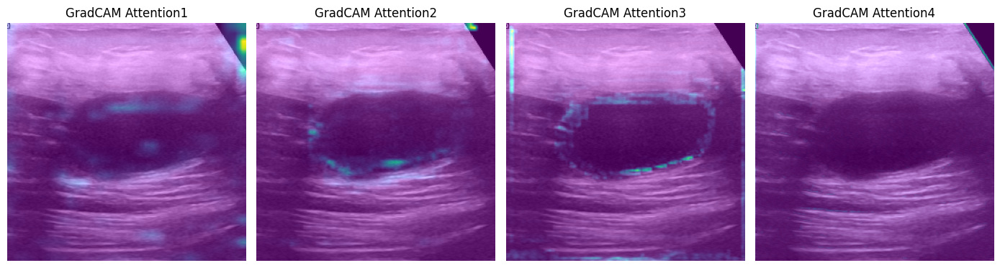

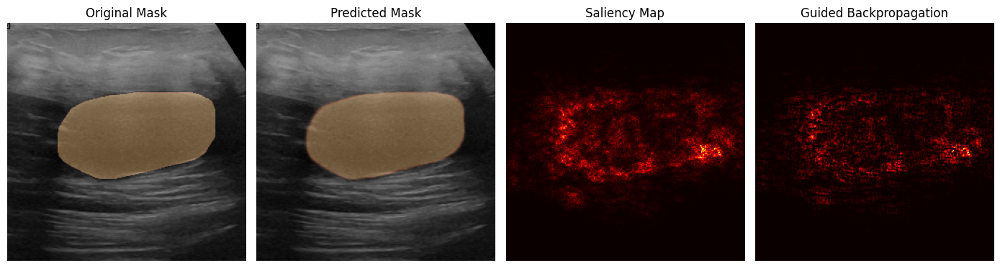

97/97 [==============================] - 13s 138ms/step - loss: 0.0096 - accuracy: 0.9942 - IoU: 0.6700 - val_loss: 0.1084 - val_accuracy: 0.9846 - val_IoU: 0.5325
Epoch 161/200
80/97 [=======================>......] - ETA: 1s - loss: 0.0095 - accuracy: 0.9944 - IoU: 0.6913

97/97 [==============================] - 8s 83ms/step - loss: 0.0095 - accuracy: 0.9944 - IoU: 0.6913 - val_loss: 0.1048 - val_accuracy: 0.9843 - val_IoU: 0.5262


In [26]:
# Config Training
BATCH_SIZE = 8
SPE = len(images)//BATCH_SIZE

# Training
results = model.fit(
    images, masks,
    validation_split=0.2,
    epochs=200,
    steps_per_epoch=SPE,
    batch_size=BATCH_SIZE,
    callbacks=cb
)

**Observations :**

* After **12 epochs** model started outputting what we needed.
* The model was easily able to detect **black round spots but fails when the shape is irregular**(Not the case with current model because it is trained with hight SPE).

* It also gets confused between the dark areas, which makes sense.



# **Evaluation**

In [27]:
loss, accuracy, iou, val_loss, val_accuracy, val_iou = results.history.values()

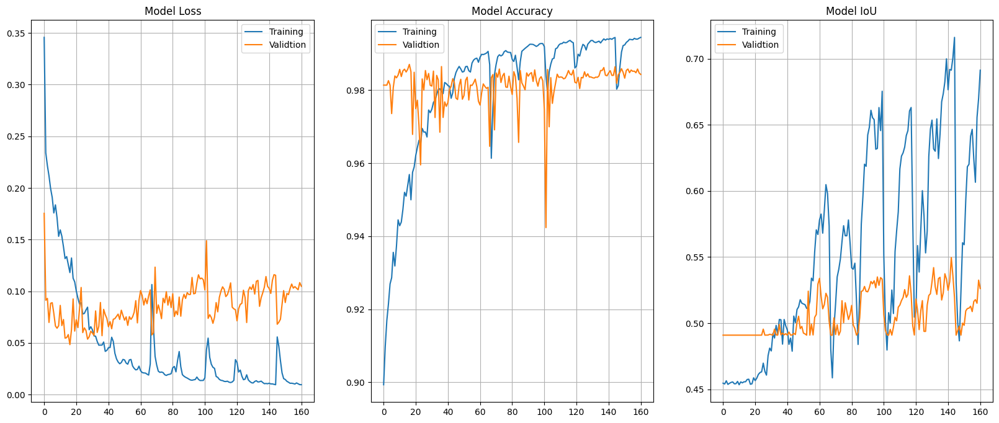

In [28]:
plt.figure(figsize=(20,8))

plt.subplot(1,3,1)
plt.title("Model Loss")
plt.plot(loss, label="Training")
plt.plot(val_loss, label="Validtion")
plt.legend()
plt.grid()

plt.subplot(1,3,2)
plt.title("Model Accuracy")
plt.plot(accuracy, label="Training")
plt.plot(val_accuracy, label="Validtion")
plt.legend()
plt.grid()

plt.subplot(1,3,3)
plt.title("Model IoU")
plt.plot(iou, label="Training")
plt.plot(val_iou, label="Validtion")
plt.legend()
plt.grid()

plt.show()

1/1 [==============================] - 0s 38ms/step


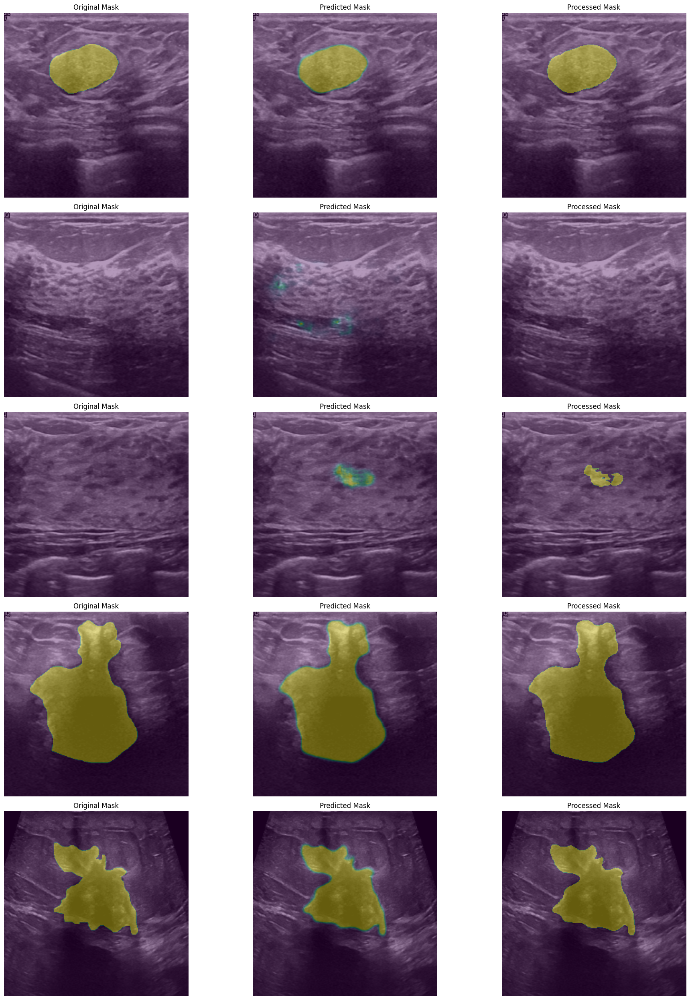

In [42]:
plt.figure(figsize=(20,25))
n=0
for i in range(1,(5*3)+1):
    plt.subplot(5,3,i)
    if n==0:
        id = np.random.randint(len(images))
        image = images[id]
        mask = masks[id]
        pred_mask = model.predict(image[np.newaxis,...])

        plt.title("Original Mask")
        show_mask(image, mask)
        n+=1
    elif n==1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
        n+=1
    elif n==2:
        pred_mask = (pred_mask>0.5).astype('float')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)
        n=0
plt.tight_layout()
plt.show()

1/1 [==============================] - 0s 22ms/step


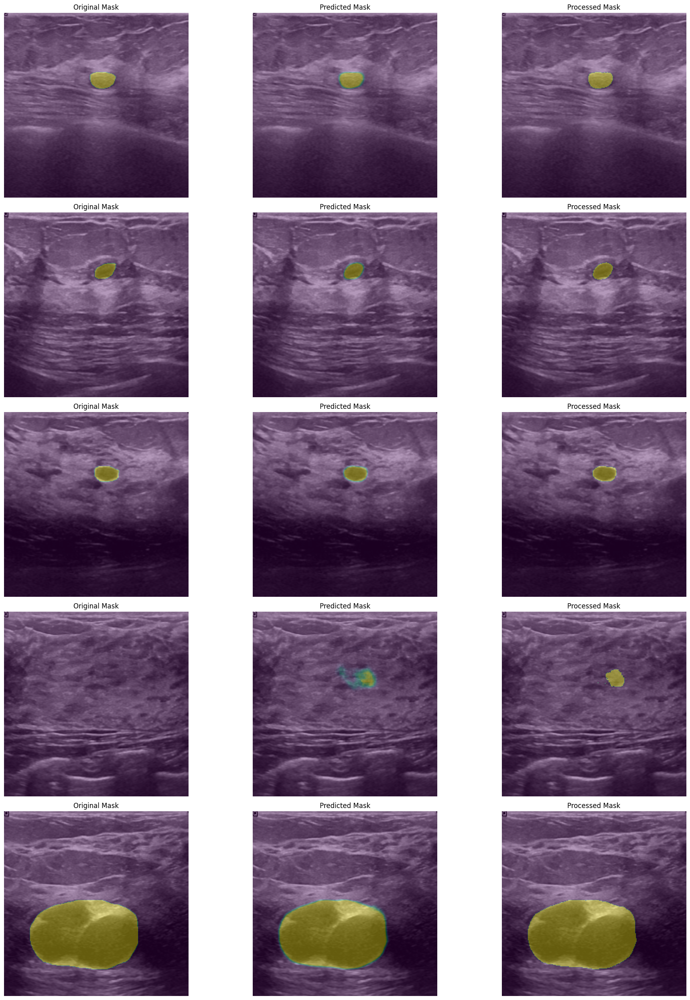

In [43]:
plt.figure(figsize=(20,25))
n=0
for i in range(1,(5*3)+1):
    plt.subplot(5,3,i)
    if n==0:
        id = np.random.randint(len(images))
        image = images[id]
        mask = masks[id]
        pred_mask = model.predict(image[np.newaxis,...])

        plt.title("Original Mask")
        show_mask(image, mask)
        n+=1
    elif n==1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
        n+=1
    elif n==2:
        pred_mask = (pred_mask>0.5).astype('float')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)
        n=0
plt.tight_layout()
plt.show()

1/1 [==============================] - 0s 28ms/step


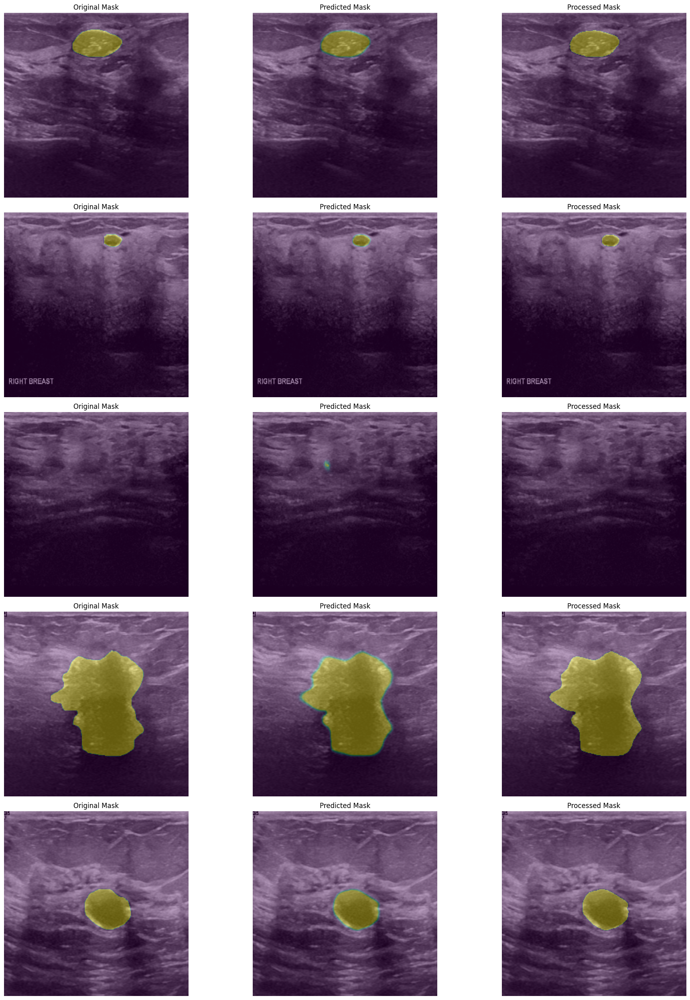

In [44]:
plt.figure(figsize=(20,25))
n=0
for i in range(1,(5*3)+1):
    plt.subplot(5,3,i)
    if n==0:
        id = np.random.randint(len(images))
        image = images[id]
        mask = masks[id]
        pred_mask = model.predict(image[np.newaxis,...])

        plt.title("Original Mask")
        show_mask(image, mask)
        n+=1
    elif n==1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
        n+=1
    elif n==2:
        pred_mask = (pred_mask>0.5).astype('float')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)
        n=0
plt.tight_layout()
plt.show()

1/1 [==============================] - 0s 23ms/step


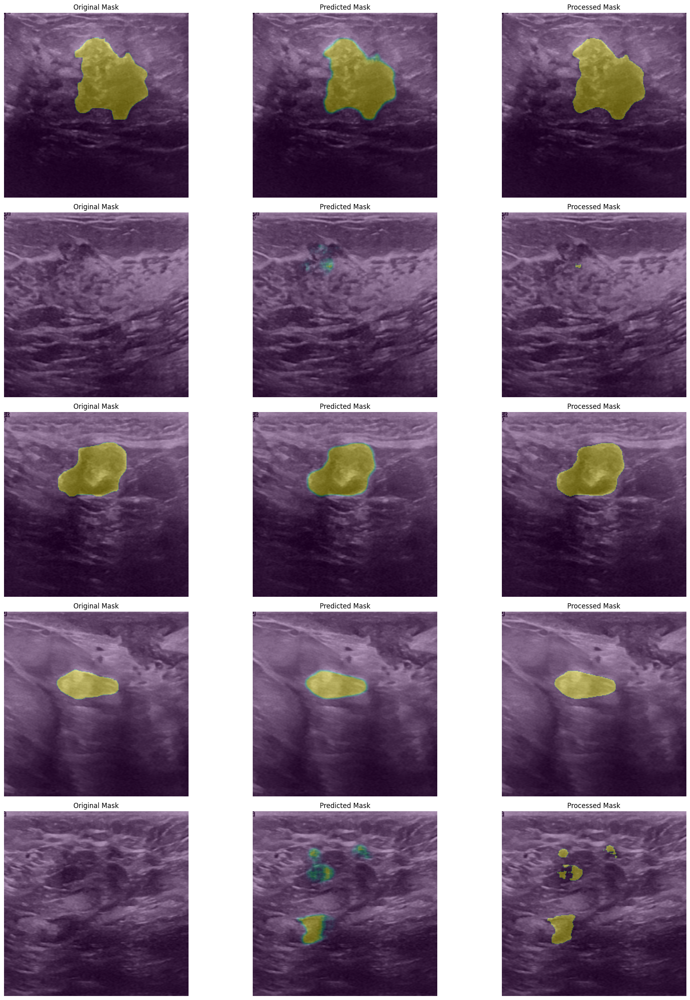

In [45]:
plt.figure(figsize=(20,25))
n=0
for i in range(1,(5*3)+1):
    plt.subplot(5,3,i)
    if n==0:
        id = np.random.randint(len(images))
        image = images[id]
        mask = masks[id]
        pred_mask = model.predict(image[np.newaxis,...])

        plt.title("Original Mask")
        show_mask(image, mask)
        n+=1
    elif n==1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
        n+=1
    elif n==2:
        pred_mask = (pred_mask>0.5).astype('float')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)
        n=0
plt.tight_layout()
plt.show()

In [ ]:
model.save('/content/drive/MyDrive/EndModelcp.h5')

In [ ]:
tf.keras.backend.clear_session()